In [22]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D , Dropout , BatchNormalization
from keras.models import Sequential
import tensorflow_hub as hub
from PIL import Image
import cv2
import matplotlib.image as mpimg
from sklearn.metrics import classification_report , confusion_matrix , accuracy_score , auc
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")

In [23]:
image_path_folder = "/content/drive/MyDrive/datasets/Sports-celebrity images"
class_labels = os.listdir(image_path_folder)
class_labels

['Kobe Bryant', 'Maria Sharapova', 'Kane Williamson', 'Ronaldo']

In [24]:
class_labels = {'Kane Williamson':0, 'Ronaldo':1, 'Maria Sharapova':2, 'Kobe Bryant':3}
class_labels['Kane Williamson']

0

In [25]:
image_data = []
label_data = []
for folder in os.listdir(image_path_folder):
    path = os.path.join(image_path_folder,folder)
    for img in os.listdir(path):
        image = Image.open(path+"/"+img)
        image = image.resize((224,224))
        image = np.array(image)
        image_data.append(image)
        label_data.append(class_labels[folder])

In [26]:
print(len(image_data))
print(len(label_data))

441
441


In [27]:
x = np.array(image_data)
y = np.array(label_data)

In [28]:
x_train, x_test ,y_train, y_test = train_test_split(x ,y , test_size=0.10, shuffle=True)
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(396, 224, 224, 3)
(45, 224, 224, 3)
(396,)
(45,)


In [29]:
x_train_scaled = x_train/255
x_test_scaled = x_test/255

In [30]:
list_labels = ['Kane Williamson', 'Ronaldo', 'Maria Sharapova', 'Kobe Bryant']

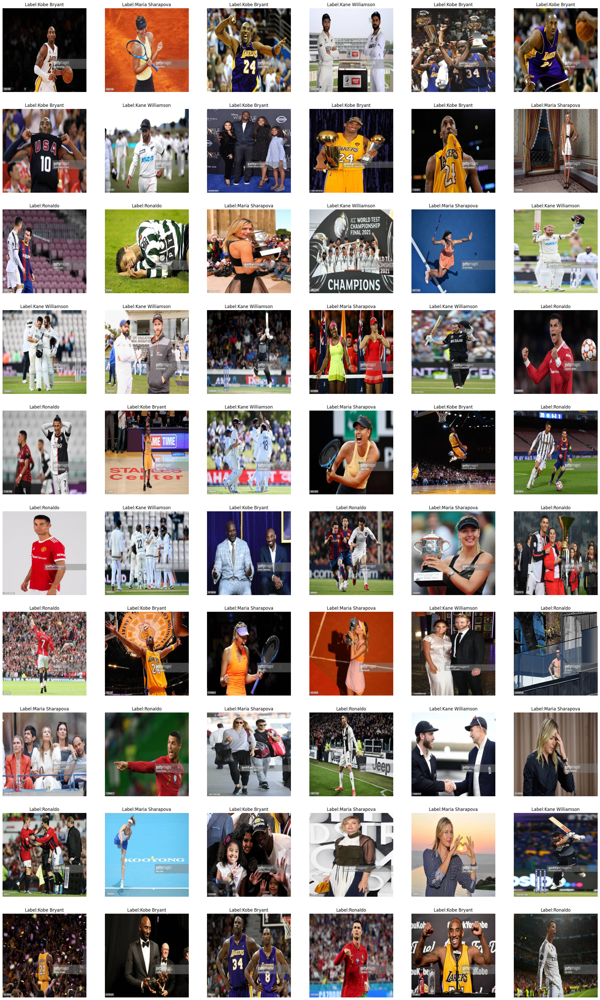

In [11]:
plt.figure(figsize=(30,50))

for i in range(60):
    plt.subplot(10,6,i+1)
    plt.imshow(x_train[i])
    plt.title(f"Label:{list_labels[y_train[i]]}")
    plt.axis("off")

In [31]:
class_labels
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomContrast(0.3),
    tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal_and_vertical'),
    tf.keras.layers.experimental.preprocessing.RandomZoom(0.3),
    tf.keras.layers.experimental.preprocessing.RandomRotation(0.2)
])

In [32]:
import tensorflow_hub as hub
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization

# URL to the MobileNetV2 model on TensorFlow Hub
url = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4"

# Load the model from TensorFlow Hub
model_hub = hub.KerasLayer(url, input_shape=(224, 224, 3), trainable=False)

num_class = 4
model = Sequential()
model.add(model_hub)
model.add(Dense(800, activation='relu'))
model.add(Dropout(0.3))
model.add(BatchNormalization())
model.add(Dense(units=num_class, activation="softmax"))

model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=["accuracy"])

model.summary()


Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1001)              3540265   
                                                                 
 dense_2 (Dense)             (None, 800)               801600    
                                                                 
 dropout_1 (Dropout)         (None, 800)               0         
                                                                 
 batch_normalization_1 (Bat  (None, 800)               3200      
 chNormalization)                                                
                                                                 
 dense_3 (Dense)             (None, 4)                 3204      
                                                                 
Total params: 4348269 (16.59 MB)
Trainable params: 806404 (3.08 MB)
Non-trainable params: 3541865 (13.51 MB)
___________

In [33]:
history = model.fit(x_train_scaled, y_train, batch_size=64 ,epochs=5,
                validation_data=(x_test_scaled,y_test)
                   )

Epoch 1/5
7/7 [==============================] - 28s 3s/step - loss: 0.9358 - accuracy: 0.6515 - val_loss: 1.0570 - val_accuracy: 0.6889
Epoch 2/5
7/7 [==============================] - 19s 3s/step - loss: 0.1803 - accuracy: 0.9394 - val_loss: 1.2074 - val_accuracy: 0.7333
Epoch 3/5
7/7 [==============================] - 19s 3s/step - loss: 0.0870 - accuracy: 0.9747 - val_loss: 1.3978 - val_accuracy: 0.7556
Epoch 4/5
7/7 [==============================] - 18s 3s/step - loss: 0.0332 - accuracy: 0.9924 - val_loss: 1.4093 - val_accuracy: 0.7556
Epoch 5/5
7/7 [==============================] - 22s 3s/step - loss: 0.0306 - accuracy: 0.9924 - val_loss: 1.4070 - val_accuracy: 0.7556


In [34]:
loss,acc = model.evaluate(x_train_scaled,y_train)
print("Loss on Train data:",loss)
print("Accuracy on Train data:",acc)

loss1,acc1 = model.evaluate(x_test_scaled, y_test)

print("Loss on Test data:",loss1)
print("Accuracy on Test data:",acc1)

13/13 [==============================] - 15s 1s/step - loss: 0.0716 - accuracy: 0.9722
Loss on Train data: 0.07162177562713623
Accuracy on Train data: 0.9722222089767456
2/2 [==============================] - 1s 343ms/step - loss: 1.4070 - accuracy: 0.7556
Loss on Test data: 1.4069693088531494
Accuracy on Test data: 0.7555555701255798


In [35]:
acc = history.history["accuracy"]
val_acc = history.history["val_accuracy"]

loss = history.history["loss"]
val_loss = history.history["val_loss"]

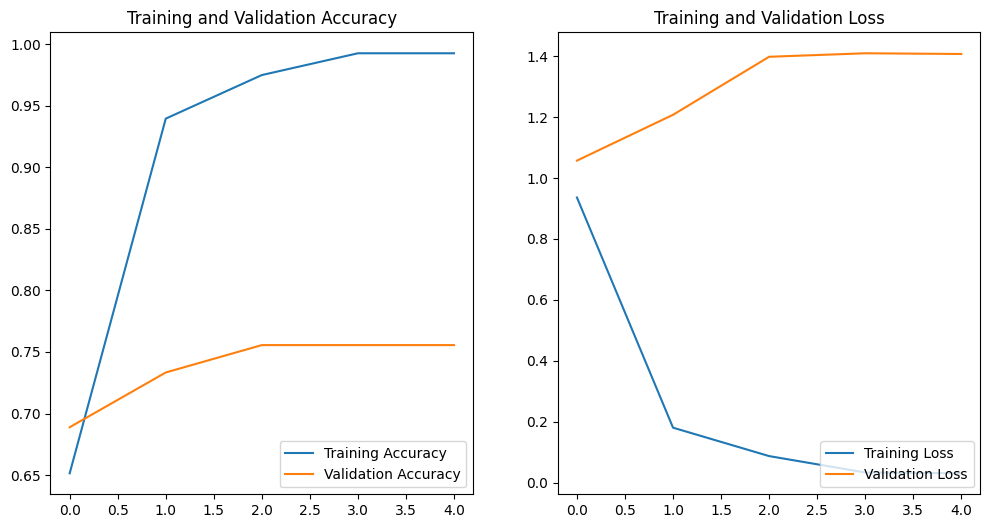

In [36]:
EPOCHS=5
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.plot(range(EPOCHS),acc, label="Training Accuracy")
plt.plot(range(EPOCHS),val_acc, label="Validation Accuracy")
plt.legend(loc="lower right")
plt.title("Training and Validation Accuracy")

#plt.figure(figsize=(6,6))
plt.subplot(1,2,2)
plt.plot(range(EPOCHS),loss, label="Training Loss")
plt.plot(range(EPOCHS),val_loss, label="Validation Loss")
plt.legend(loc="lower right")
plt.title("Training and Validation Loss")
plt.show()

In [37]:
y_pred = model.predict(x_test_scaled)
y_pred = [np.argmax(i) for i in y_pred]

2/2 [==============================] - 2s 346ms/step


In [38]:
print("Confusion Matrix:\n",confusion_matrix(y_test,y_pred))
print()
print("Classification Report:",classification_report(y_test,y_pred))

Confusion Matrix:
 [[10  5  0  0]
 [ 0  9  0  0]
 [ 0  2  6  0]
 [ 1  3  0  9]]

Classification Report:               precision    recall  f1-score   support

           0       0.91      0.67      0.77        15
           1       0.47      1.00      0.64         9
           2       1.00      0.75      0.86         8
           3       1.00      0.69      0.82        13

    accuracy                           0.76        45
   macro avg       0.85      0.78      0.77        45
weighted avg       0.86      0.76      0.77        45



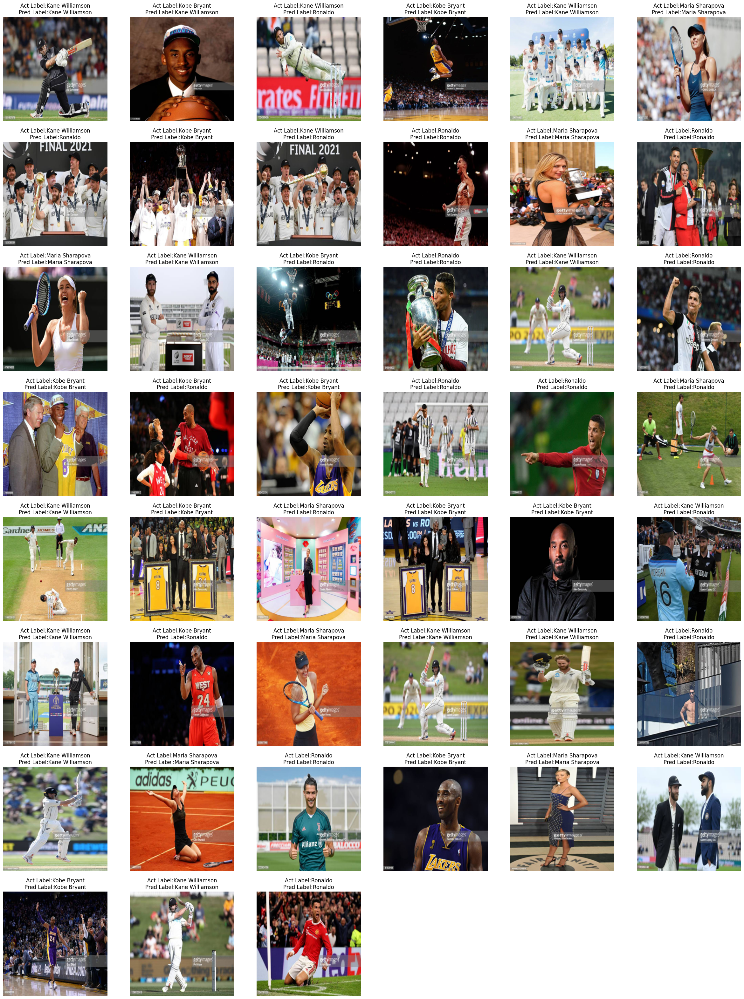

In [39]:
plt.figure(figsize=(30,40))
for i in range(45):
    plt.subplot(8,6,i+1)
    plt.imshow(x_test[i])
    plt.title(f"Act Label:{list_labels[y_test[i]]}\nPred Label:{list_labels[y_pred[i]]}")
    plt.axis("off")